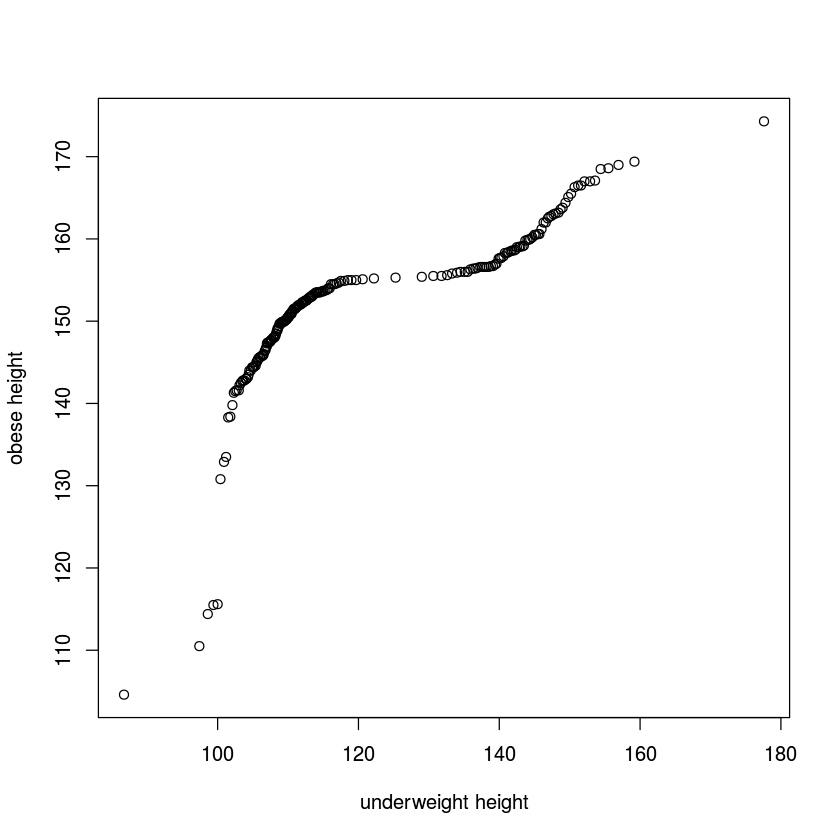

NULL

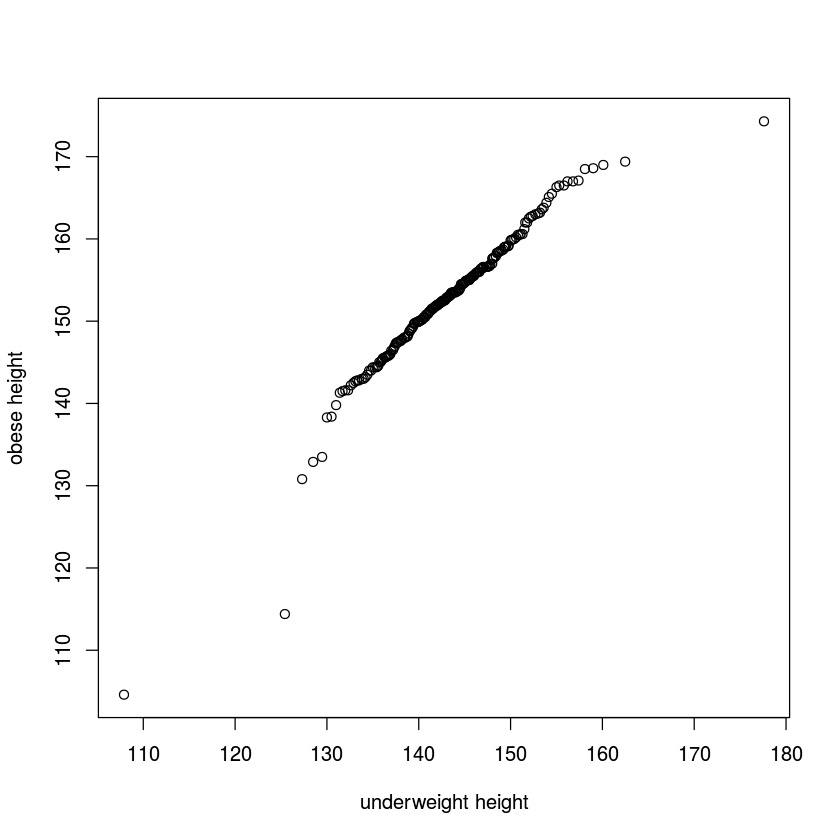

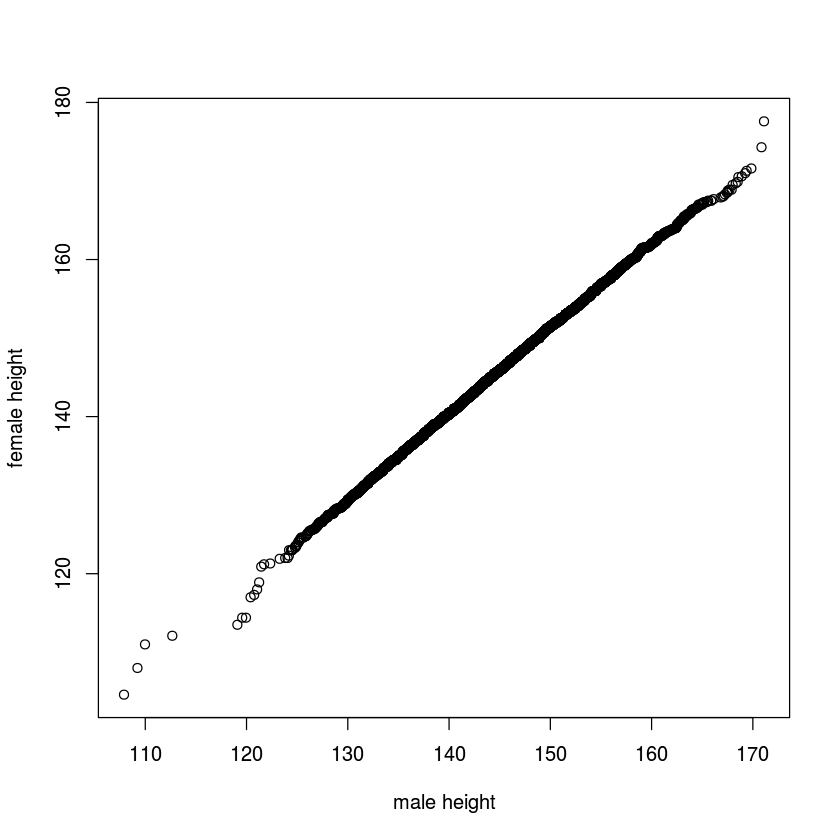

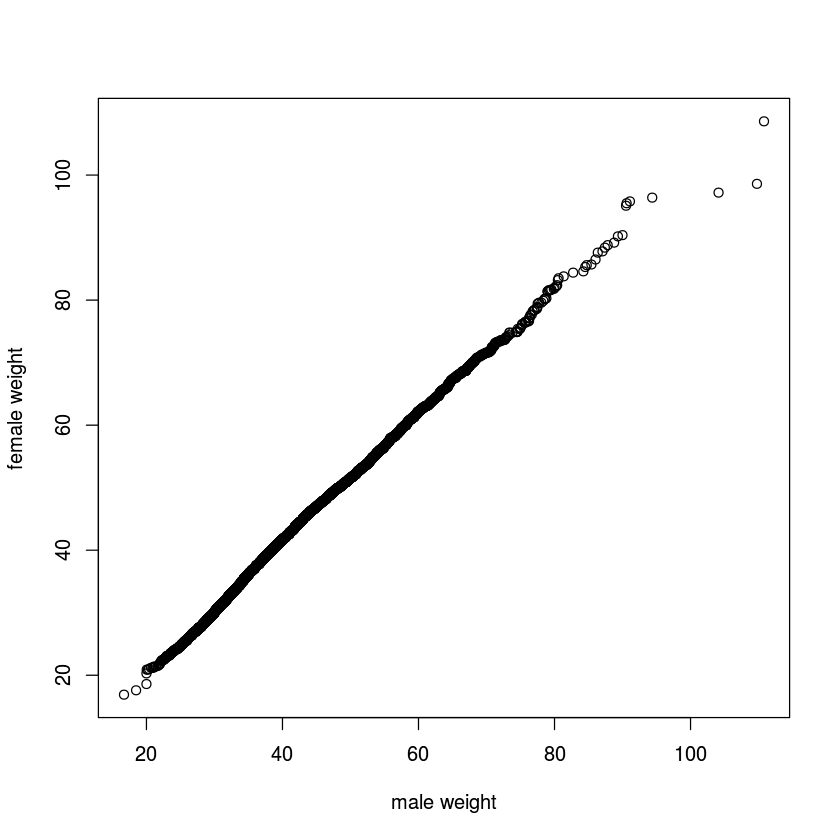

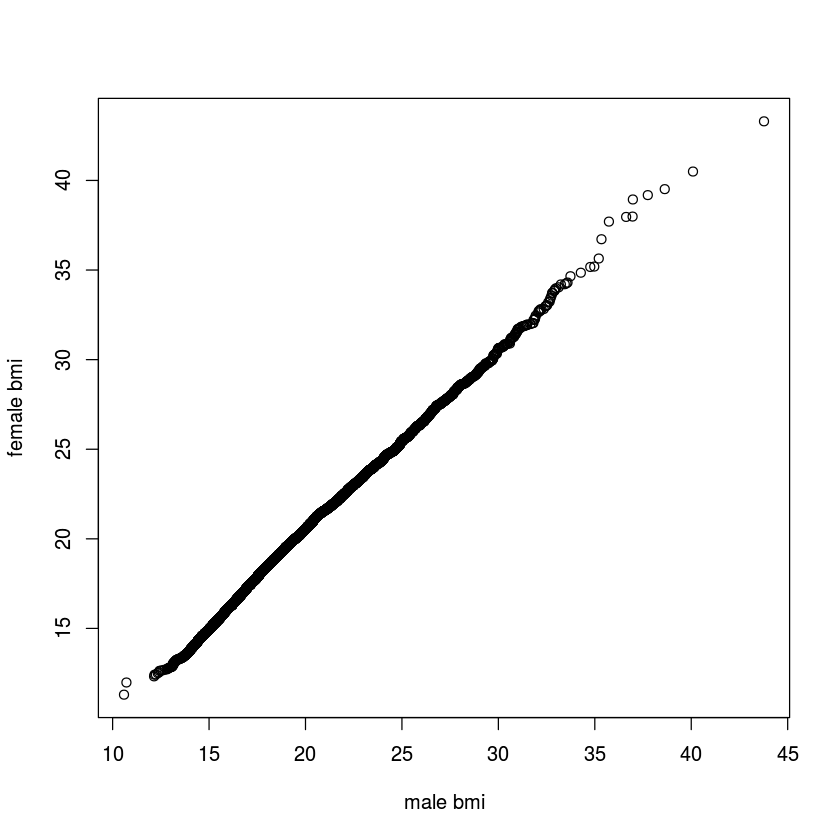

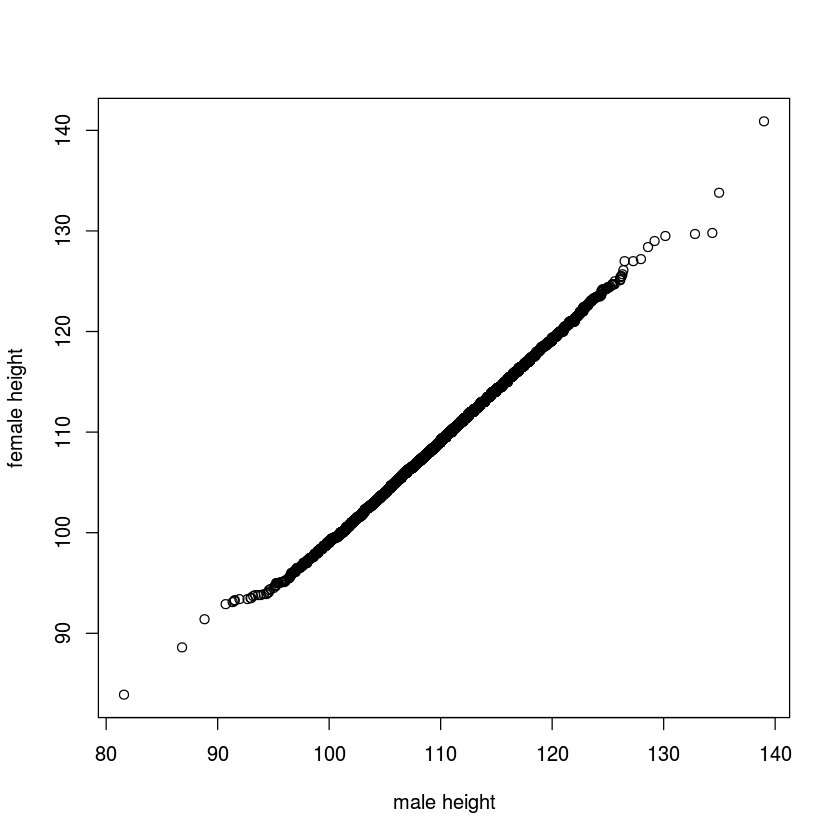

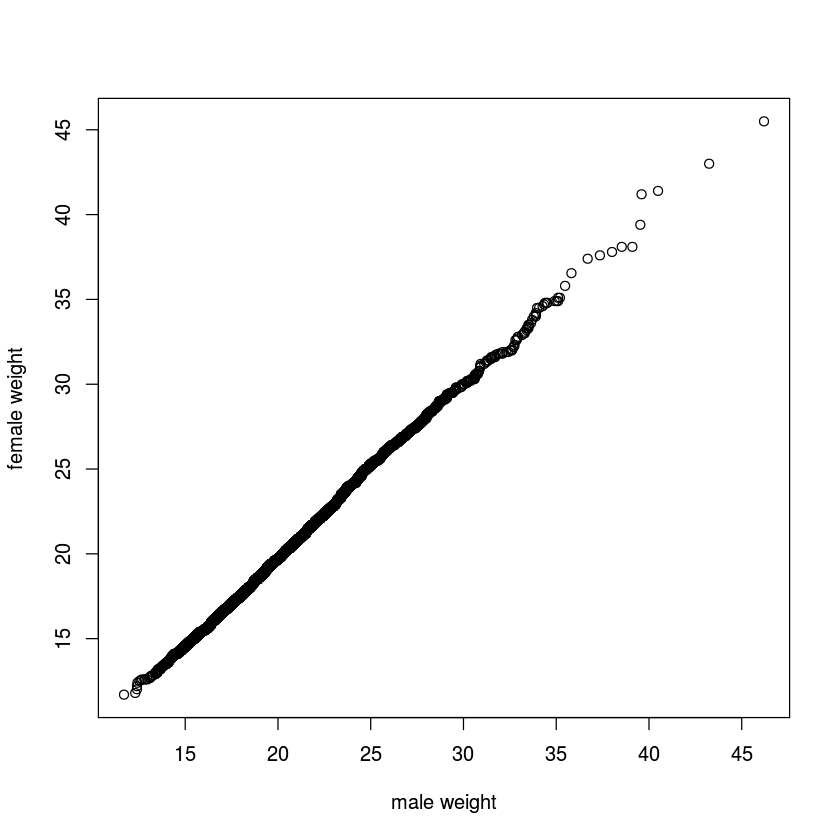

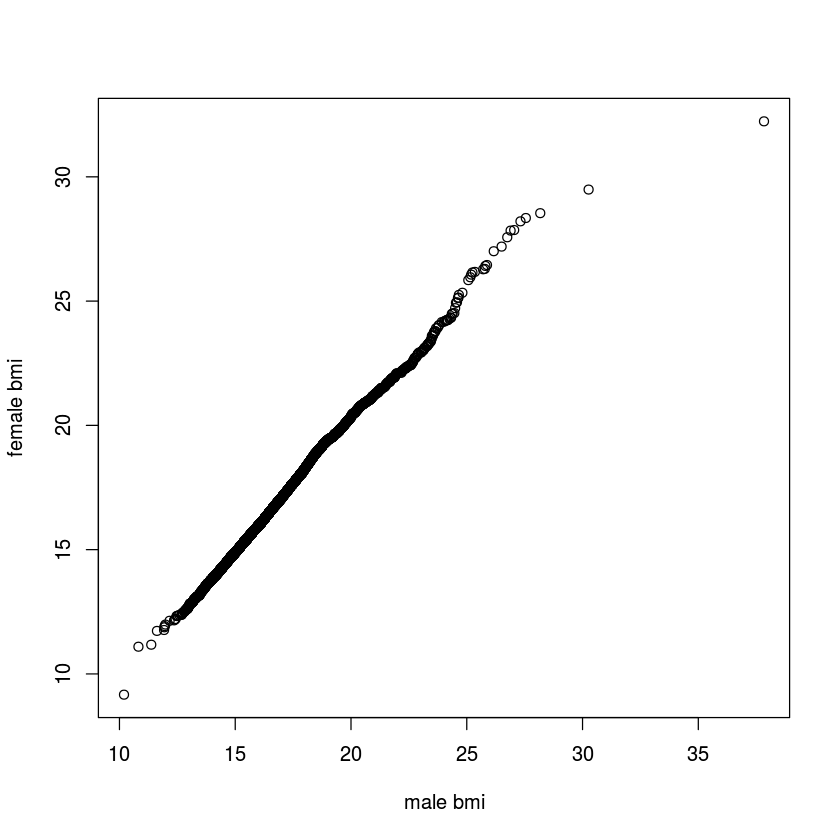

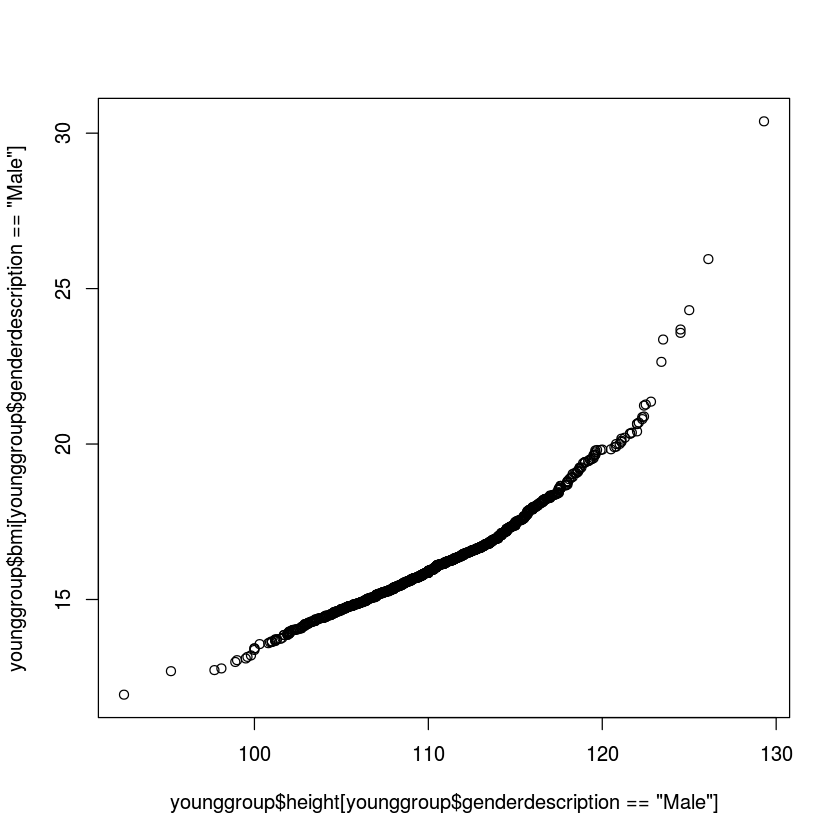

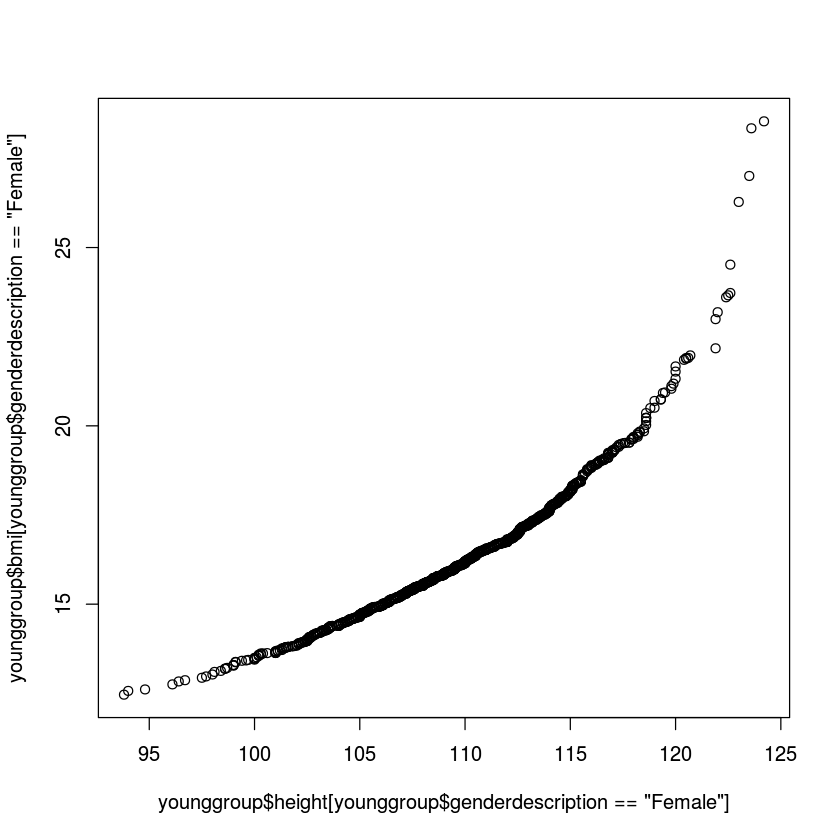

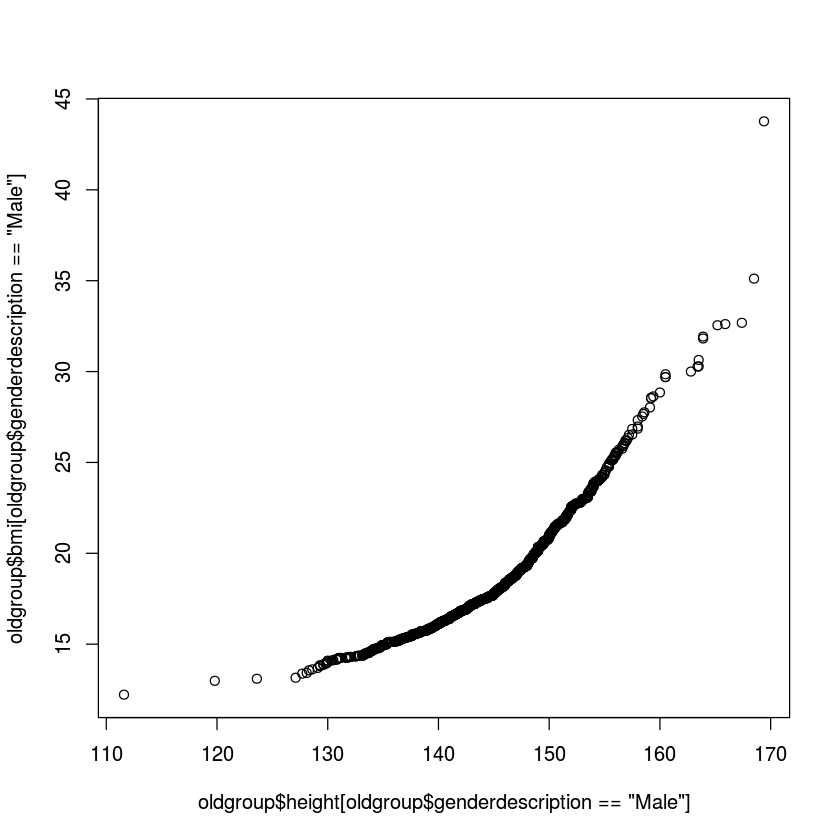

[1] 1362

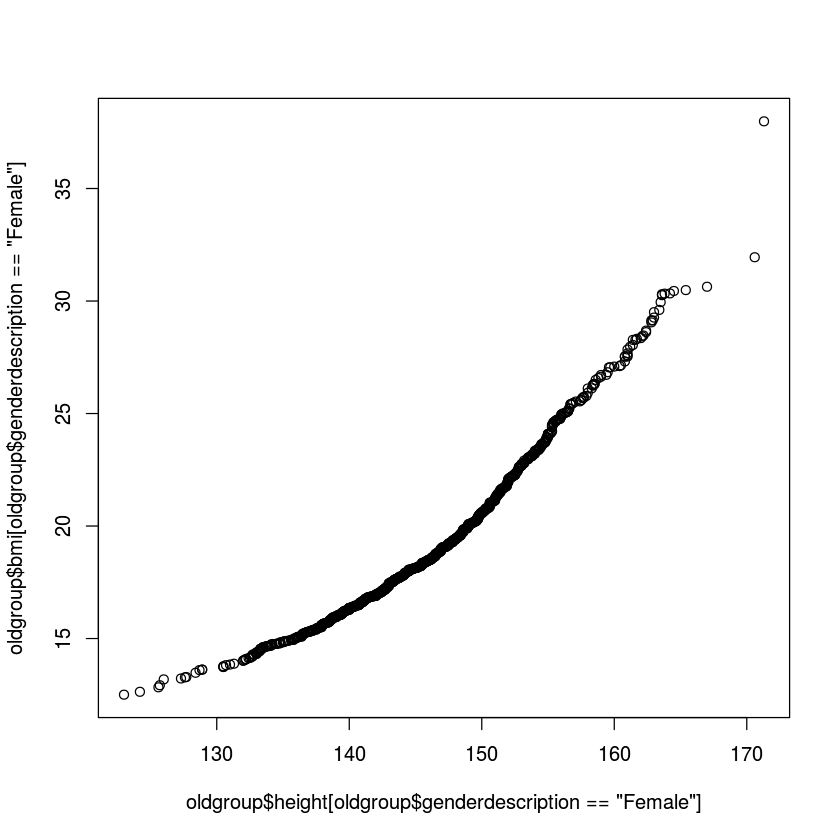

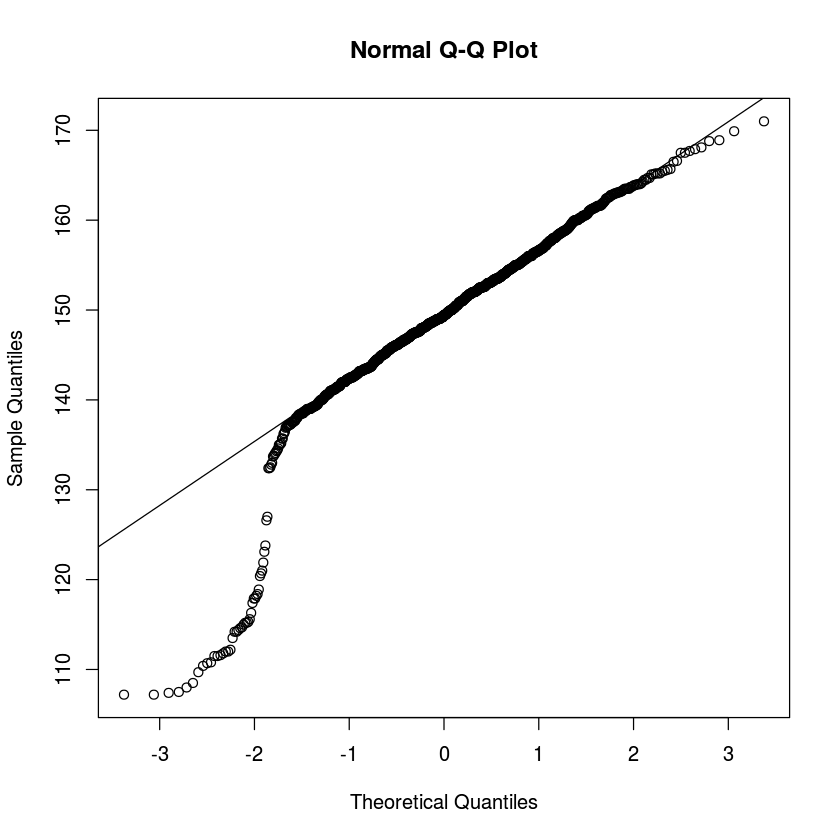

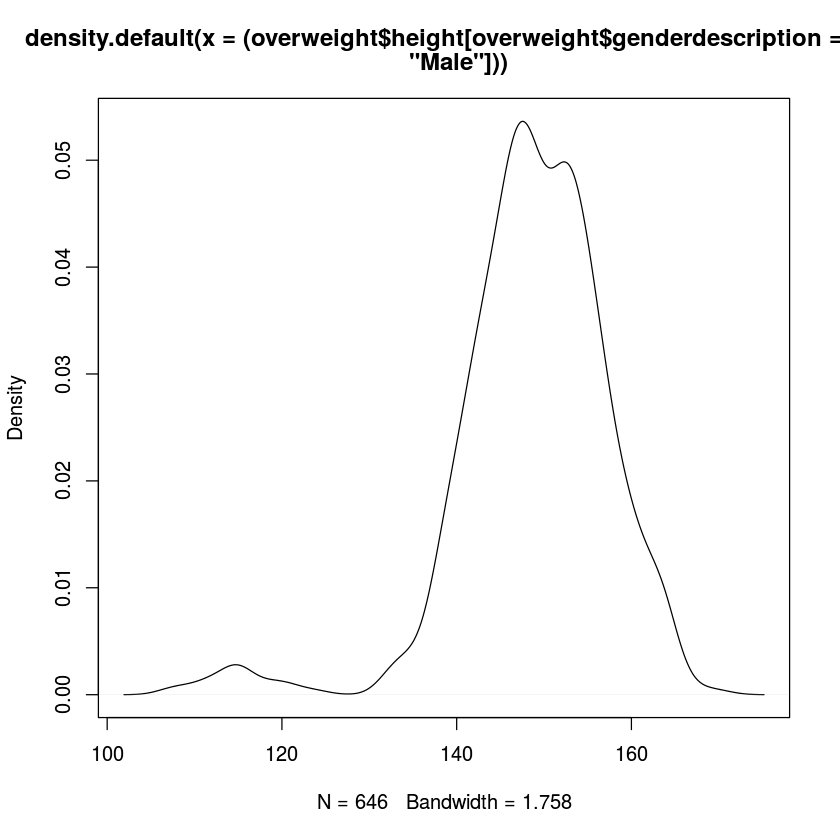

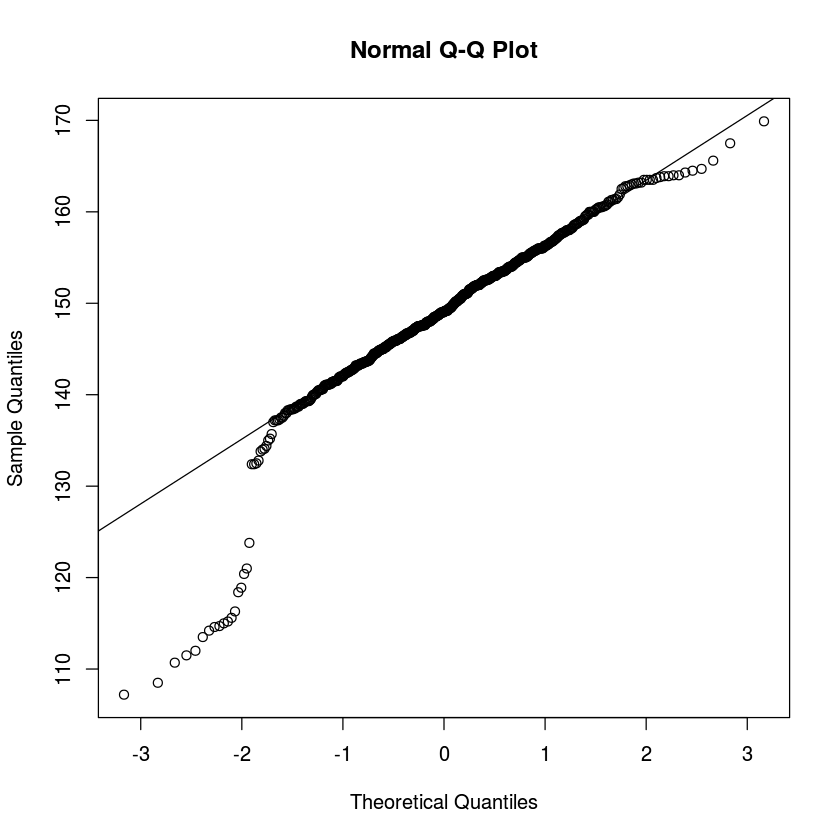

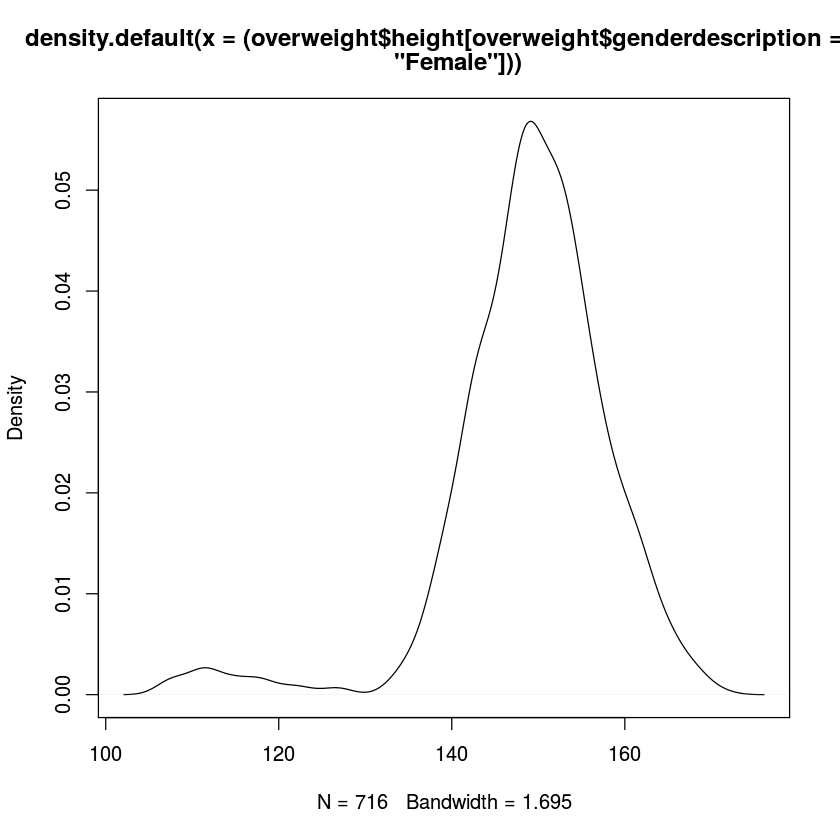

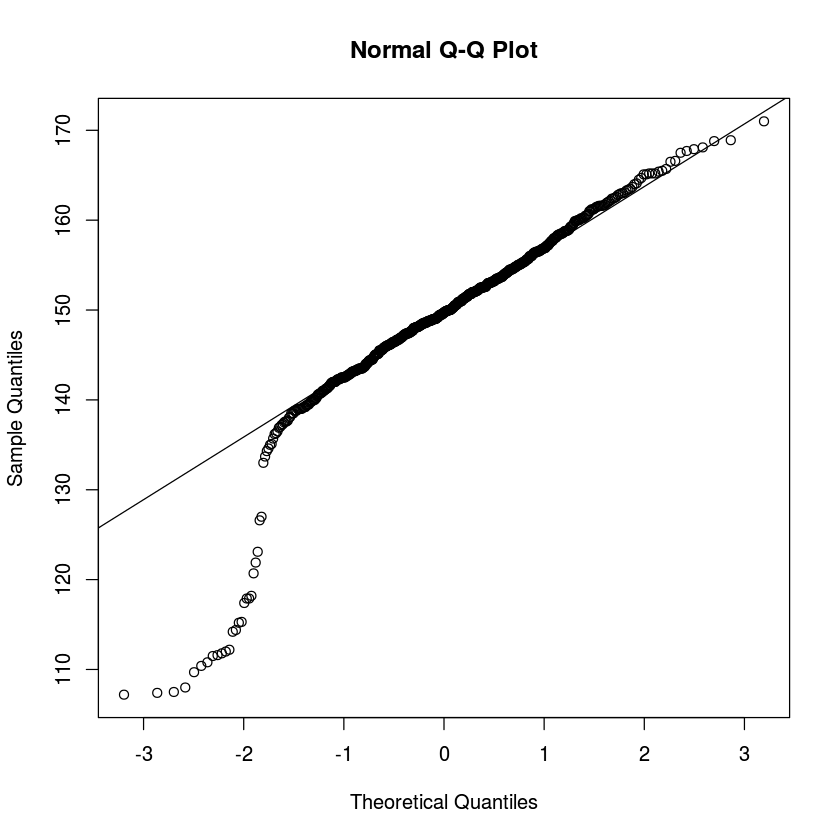

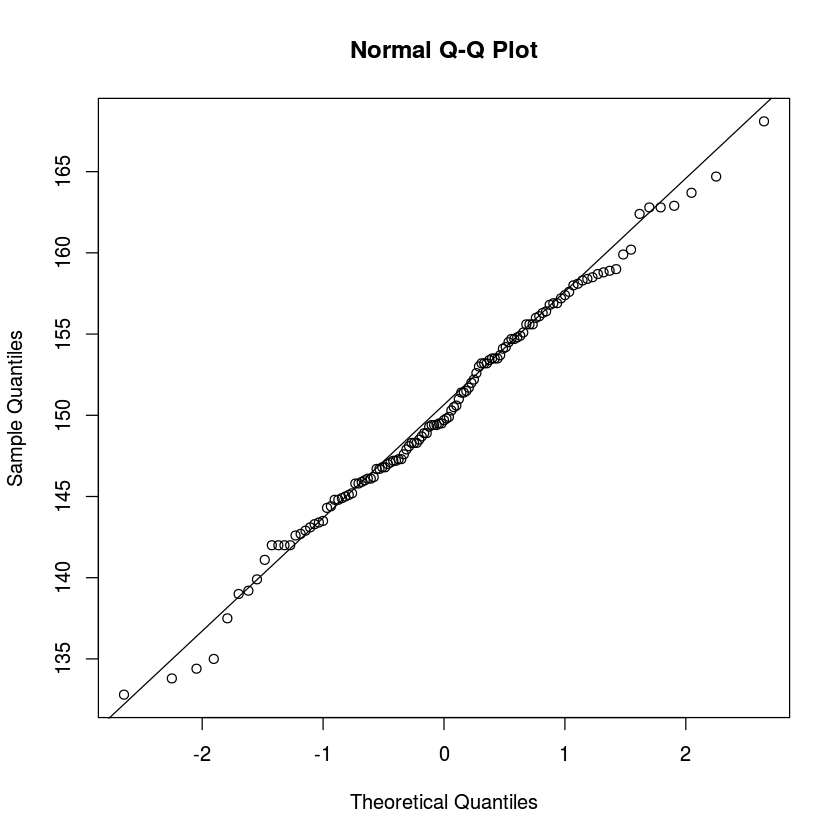

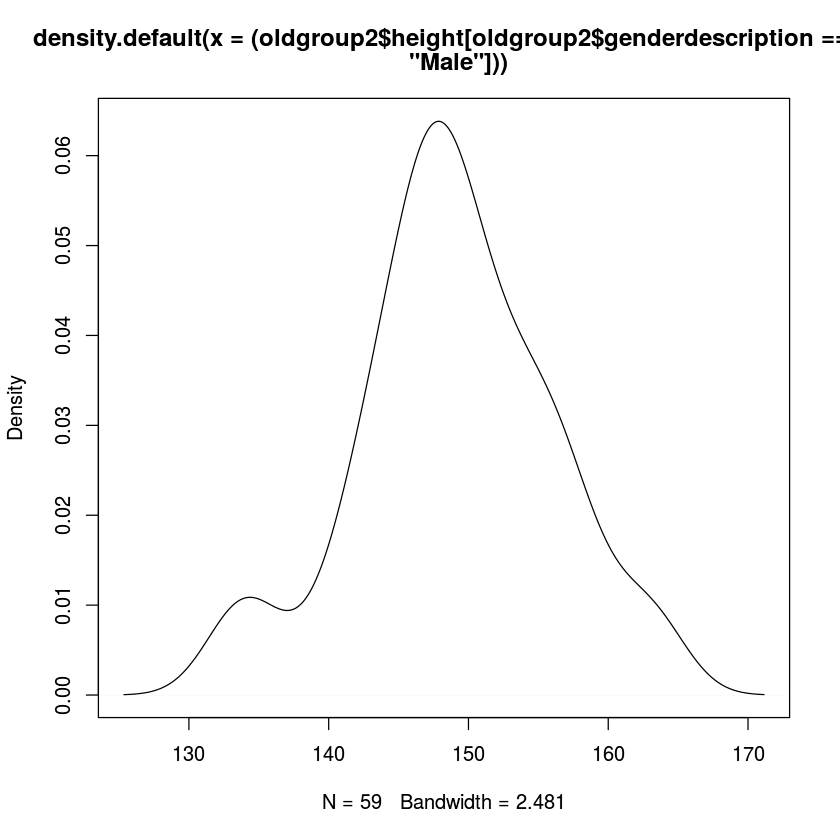

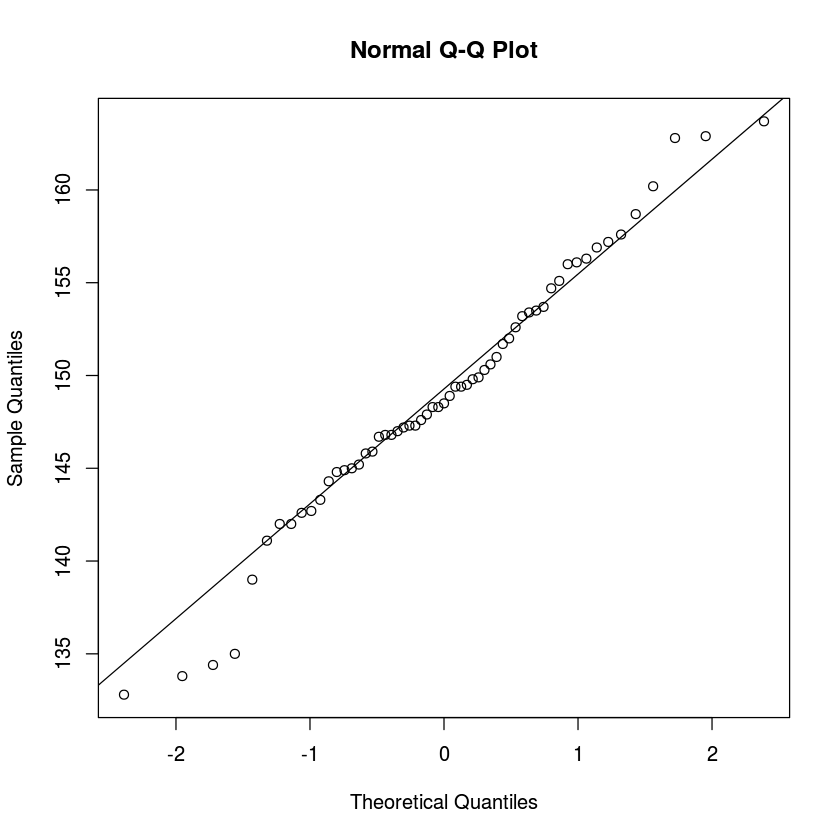

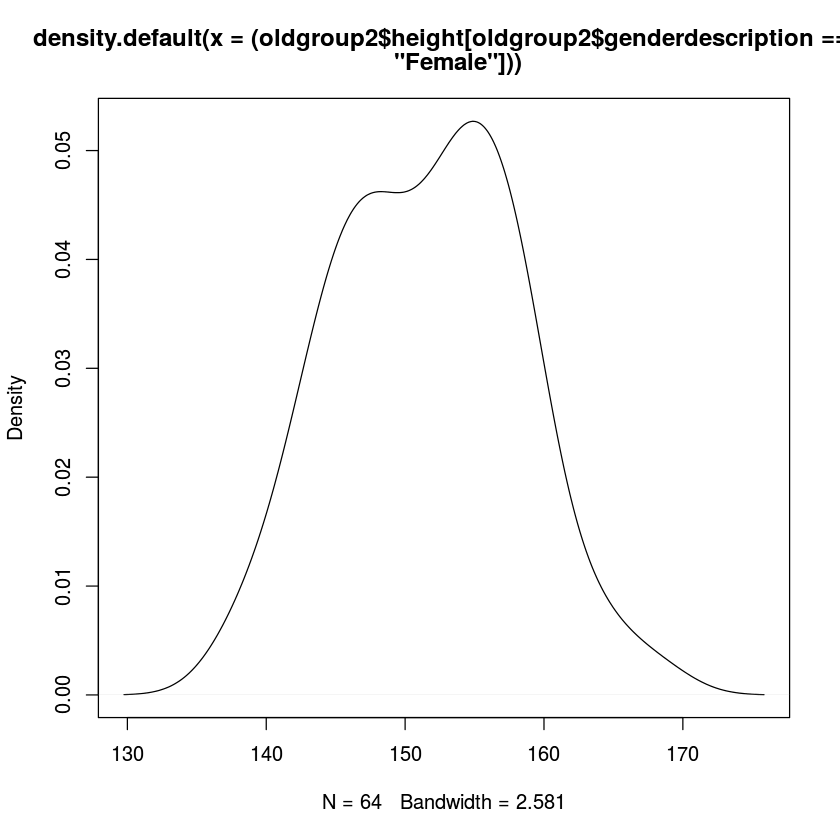

,A,B,C,D,E,F,G,H
A,5,1,3,0,3,3,1,3
B,1,5,2,3,3,2,0,3
C,3,2,5,1,3,4,0,4
D,0,3,1,3,2,1,0,1
E,3,3,3,2,7,3,1,3
F,3,2,4,1,3,5,0,3
G,1,0,0,0,1,0,1,0
H,3,3,4,1,3,3,0,6


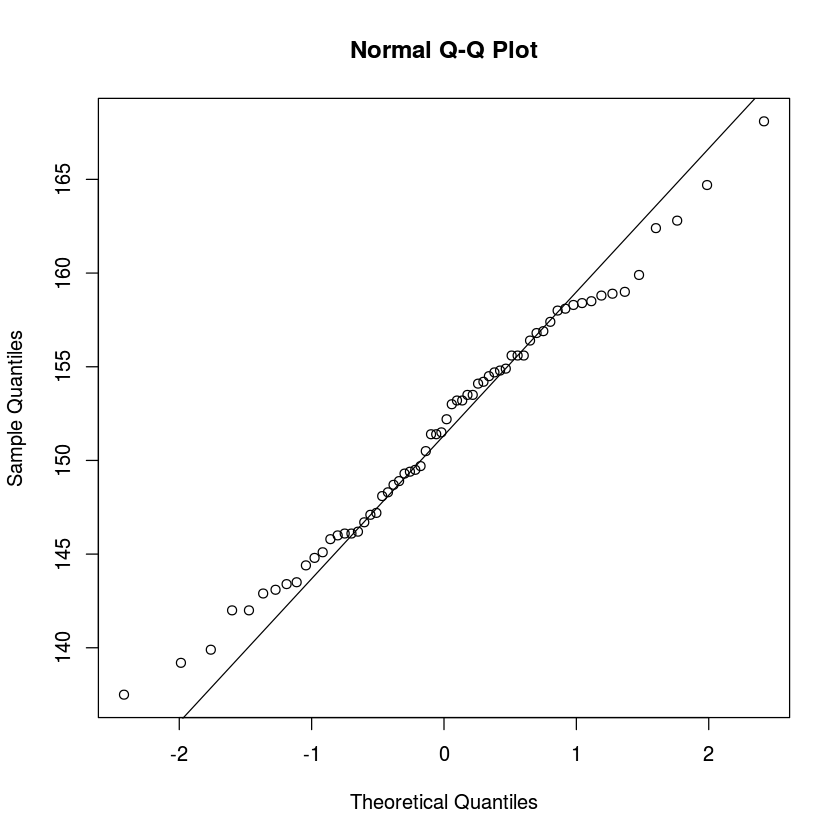

,A,B,C,D,E,F,G,H
A,1.0,0.2,0.6,0.0,0.6,0.6,0.2,0.6
B,0.2,1.0,0.4,0.6,0.6,0.4,0.0,0.6
C,0.6,0.4,1.0,0.2,0.6,0.8,0.0,0.8
D,0.00,1.00,0.33,1.00,0.67,0.33,0.00,0.33
E,0.43,0.43,0.43,0.29,1.00,0.43,0.14,0.43
F,0.6,0.4,0.8,0.2,0.6,1.0,0.0,0.6
G,1,0,0,0,1,0,1,0
H,0.50,0.50,0.67,0.17,0.50,0.50,0.00,1.00


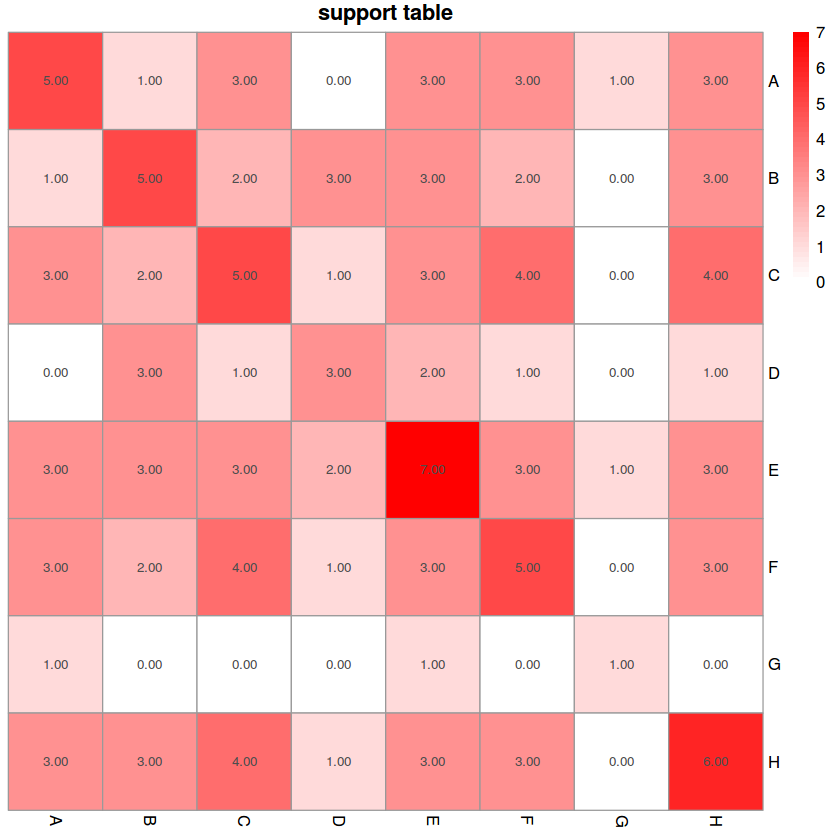

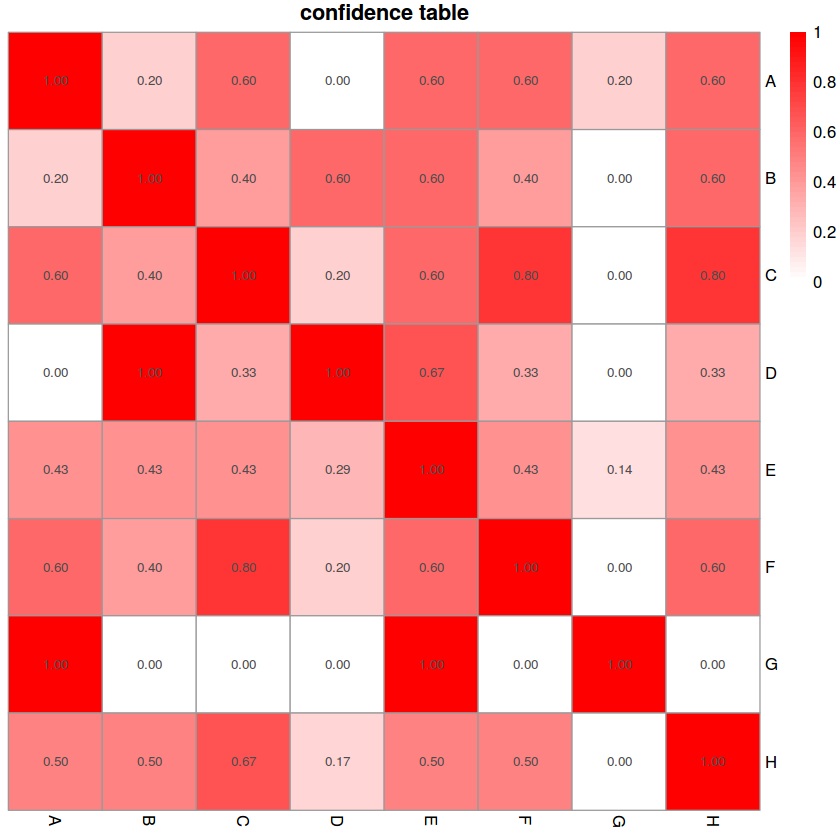

In [1]:
#clear data

rm(list=ls())
library(pheatmap)

dat = read.csv("https://kodu.ut.ee/~ilyav/pubs/ncmp_1314_final_non_disclosive.csv", header = TRUE)


# clean the data
dat = dat[dat$ageinmonths>=0 & dat$height>=0 & dat$weight>=0 & dat$bmi>=0,]

# set the bmi group
dat$bmigroup[dat$bmi<18.5] = "underweight"
dat$bmigroup[dat$bmi>=18.5 & dat$bmi<=25] = "normal"
dat$bmigroup[dat$bmi>25 & dat$bmi<=30] = "overweight"
dat$bmigroup[dat$bmi>30] = "obese"

# set the age group
dat$agegroup[dat$ageinmonths<70] = "younger"
dat$agegroup[dat$ageinmonths>70] = "older"

write.csv(dat, file = "homework5.csv", row.names = FALSE)

# Question 1
# qqplots
qqplot(dat$height[dat$bmigroup == "underweight"], 
       dat$height[dat$bmigroup == "obese"], 
       xlab="underweight height", ylab="obese height")
qqplot(dat$height[dat$bmigroup == "underweight" & dat$agegroup == "older"],
       dat$height[dat$bmigroup == "obese" & dat$agegroup == "older"], 
       xlab="underweight height", ylab="obese height")
#no obese for younger people
nrow(dat$height[dat$bmigroup == "obese" & dat$agegroup == "younger"])

qqplot(dat$height[dat$agegroup == "older" & dat$genderdescription == "Male"],
       dat$height[dat$agegroup == "older" & dat$genderdescription == "Female"], 
       xlab="male height", ylab="female height")
qqplot(dat$weight[dat$agegroup == "older" & dat$genderdescription == "Male"],
       dat$weight[dat$agegroup == "older" & dat$genderdescription == "Female"], 
       xlab="male weight", ylab="female weight")
qqplot(dat$bmi[dat$agegroup == "older" & dat$genderdescription == "Male"],
       dat$bmi[dat$agegroup == "older" & dat$genderdescription == "Female"], 
       xlab="male bmi", ylab="female bmi")

qqplot(dat$height[dat$agegroup == "younger" & dat$genderdescription == "Male"],
       dat$height[dat$agegroup == "younger" & dat$genderdescription == "Female"], 
       xlab="male height", ylab="female height")
qqplot(dat$weight[dat$agegroup == "younger" & dat$genderdescription == "Male"],
       dat$weight[dat$agegroup == "younger" & dat$genderdescription == "Female"], 
       xlab="male weight", ylab="female weight")
qqplot(dat$bmi[dat$agegroup == "younger" & dat$genderdescription == "Male"],
       dat$bmi[dat$agegroup == "younger" & dat$genderdescription == "Female"], 
       xlab="male bmi", ylab="female bmi")

# Question 2
dat$age = floor(dat$ageinmonths)

# getting the data with the greatest number of occurences
younggroup = subset(dat, age == strtoi(names(sort(table(dat$age[dat$agegroup == "younger"]), decreasing=TRUE))[1]))
oldgroup = subset(dat, age == strtoi(names(sort(table(dat$age[dat$agegroup == "older"]), decreasing=TRUE))[1]))

# young group
qqplot(younggroup$height[younggroup$genderdescription == "Male"], younggroup$bmi[younggroup$genderdescription == "Male"])
qqplot(younggroup$height[younggroup$genderdescription == "Female"], younggroup$bmi[younggroup$genderdescription == "Female"])

# old group
qqplot(oldgroup$height[oldgroup$genderdescription == "Male"], oldgroup$bmi[oldgroup$genderdescription == "Male"])
qqplot(oldgroup$height[oldgroup$genderdescription == "Female"], oldgroup$bmi[oldgroup$genderdescription == "Female"])

# Question 3
# get overweight children
overweight = subset(dat, bmigroup == "overweight")
nrow(overweight)
# all overweight children
qqnorm(overweight$height); qqline(overweight$height)
# all overweight male children
plot(density((overweight$height[overweight$genderdescription == "Male"])))
qqnorm(overweight$height[overweight$genderdescription == "Male"])
qqline(overweight$height[overweight$genderdescription == "Male"])
# all overweight female children
plot(density((overweight$height[overweight$genderdescription == "Female"])))
qqnorm(overweight$height[overweight$genderdescription == "Female"])
qqline(overweight$height[overweight$genderdescription == "Female"])

oldgroup2 = subset(overweight, age == strtoi(names(sort(table(overweight$age[overweight$agegroup == "older"]), decreasing=TRUE))[1]))
# all overweight children
qqnorm(oldgroup2$height); qqline(oldgroup2$height)
# all overweight male children
plot(density((oldgroup2$height[oldgroup2$genderdescription == "Male"])))
qqnorm(oldgroup2$height[oldgroup2$genderdescription == "Male"])
qqline(oldgroup2$height[oldgroup2$genderdescription == "Male"])
# all overweight female children
plot(density((oldgroup2$height[oldgroup2$genderdescription == "Female"])))
qqnorm(oldgroup2$height[oldgroup2$genderdescription == "Female"])
qqline(oldgroup2$height[oldgroup2$genderdescription == "Female"])


#Question 4

letters = c("A", "B", "C", "D", "E", "F", "G", "H")
letterdata = matrix( 
  c(1,1,1,0,0,1,0,1,
    0,0,1,0,1,1,0,1,
    0,1,0,1,1,0,0,0,
    1,0,1,0,0,1,0,1,
    1,0,0,0,1,1,0,0,
    0,1,0,1,0,0,0,1,
    0,1,1,1,1,1,0,0,
    1,0,1,0,1,0,0,1,
    1,0,0,0,1,0,1,0,
    0,1,0,0,1,0,0,1), 
  ncol=8,
  nrow=10, byrow = TRUE)
letterdata = as.data.frame(letterdata)
colnames(letterdata) = letters

# 1 letter
#nrow(subset(letterdata, A==1)) #5
#nrow(subset(letterdata, B==1)) #5
#nrow(subset(letterdata, C==1)) #5
#nrow(subset(letterdata, D==1)) #3
#nrow(subset(letterdata, E==1)) #7
#nrow(subset(letterdata, F==1)) #5
#nrow(subset(letterdata, G==1)) #1
#nrow(subset(letterdata, H==1)) #6

#2 letters (not including G cause it has a support of 1 in 1 letter support check)
#nrow(subset(letterdata, A==1 & B==1)) #1
#nrow(subset(letterdata, A==1 & C==1)) #3
#nrow(subset(letterdata, A==1 & D==1)) #0
#nrow(subset(letterdata, A==1 & E==1)) #3
#nrow(subset(letterdata, A==1 & F==1)) #3
#nrow(subset(letterdata, A==1 & H==1)) #3

#nrow(subset(letterdata, B==1 & C==1)) #2
#nrow(subset(letterdata, B==1 & D==1)) #3
#nrow(subset(letterdata, B==1 & E==1)) #3
#nrow(subset(letterdata, B==1 & F==1)) #2
#nrow(subset(letterdata, B==1 & H==1)) #3

#nrow(subset(letterdata, C==1 & D==1)) #1
#nrow(subset(letterdata, C==1 & E==1)) #3
#nrow(subset(letterdata, C==1 & F==1)) #4
#nrow(subset(letterdata, C==1 & H==1)) #4

#nrow(subset(letterdata, D==1 & E==1)) #2
#nrow(subset(letterdata, D==1 & F==1)) #1
#nrow(subset(letterdata, D==1 & H==1)) #1

#nrow(subset(letterdata, E==1 & F==1)) #3
#nrow(subset(letterdata, E==1 & H==1)) #3

#nrow(subset(letterdata, F==1 & H==1)) #3

#nrow(subset(letterdata, G==1 & H==1)) #0

#3 letters (continued where support was greater than or equal to 3)
#nrow(subset(letterdata, A==1 & C==1 & E==1)) #1
#nrow(subset(letterdata, A==1 & C==1 & F==1)) #2
#nrow(subset(letterdata, A==1 & C==1 & H==1)) #3
#nrow(subset(letterdata, A==1 & E==1 & F==1)) #1
#nrow(subset(letterdata, A==1 & E==1 & H==1)) #1
#nrow(subset(letterdata, A==1 & F==1 & H==1)) #2
#nrow(subset(letterdata, A==1 & B==1 & H==1)) #1

#nrow(subset(letterdata, B==1 & D==1 & E==1)) #2
#nrow(subset(letterdata, B==1 & D==1 & H==1)) #1
#nrow(subset(letterdata, B==1 & E==1 & H==1)) #1
#nrow(subset(letterdata, B==1 & E==1 & F==1)) #1
#nrow(subset(letterdata, B==1 & C==1 & H==1)) #1
#nrow(subset(letterdata, B==1 & F==1 & H==1)) #1

#nrow(subset(letterdata, C==1 & E==1 & F==1)) #2
#nrow(subset(letterdata, C==1 & E==1 & H==1)) #2
#nrow(subset(letterdata, C==1 & F==1 & H==1)) #3

#4 letters
#nrow(subset(letterdata, A==1 & C==1 & F==1 & H==1)) #2

# stop here cause there will be no support of 3 for 5 letters based on the Apriori principle

#Question 5
supportT = matrix(nrow=8, ncol=8)
row.names(supportT) = letters
colnames(supportT) = letters

for(letter in letters){
  for(letter2 in letters){
    count = 0
    for(i in 1:10){
      if(letterdata[i,letter] == 1 & letterdata[i,letter2] == 1){
        count = count + 1
      }
    }
    supportT[letter, letter2] = count
  }
}
#this is the data for supportT (not in relative support but in count)
supportT
pheatmap(supportT, cluster_rows = F, cluster_cols = F, main = "support table",
         color = colorRampPalette(c("white", "red"))(50),display_numbers = T)

#confidence
confidenceT = supportT
for(letter in letters){
  for(letter2 in letters){
    supportCount = 0
    coverCount = 0
    for(i in 1:10){
      if(letterdata[i,letter] == 1){
        coverCount = coverCount + 1
      }
      if(letterdata[i,letter] == 1 & letterdata[i,letter2] == 1){
        supportCount = supportCount + 1
      }
    }
    confidenceT[letter, letter2] = round((supportCount/coverCount), 2)
  }
}
#this is the data for confidenceT
confidenceT
pheatmap(confidenceT, cluster_rows = F, cluster_cols = F, main = "confidence table",
         color = colorRampPalette(c("white", "red"))(50),display_numbers = T)
